In [1]:
import pandas as pd

IMAGE_PATH = "./data_source/images/"
TEST_PATH = "./data_source/test.csv"
TRAIN_PATH = "./data_source/train.csv"
SUB_PATH = "./data_source/sample_submission.csv"

sub = pd.read_csv(SUB_PATH)
test_data = pd.read_csv(TEST_PATH)
train_data = pd.read_csv(TRAIN_PATH)

In [2]:
from matplotlib import image
from numpy import asarray
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

def load_image(image_id,size):  
    file_path = image_id + ".jpg"
    with Image.open(IMAGE_PATH + file_path) as image:
        image = image.resize(size)
    return np.asarray(image) / 255.

In [53]:
import random
import shutil
import os

NEW_DATA_DIR = './data'
TRAIN_DIR = NEW_DATA_DIR + '/Train'
TEST_DIR = NEW_DATA_DIR + '/Test'
VALID_DIR = NEW_DATA_DIR + '/Valid'
test_size = 0.10

# Create dir structure
shutil.rmtree(NEW_DATA_DIR)
os.mkdir(NEW_DATA_DIR)
os.mkdir(TRAIN_DIR)
os.mkdir(TRAIN_DIR+'/healthy')
os.mkdir(TRAIN_DIR+'/multiple_diseases')
os.mkdir(TRAIN_DIR+'/rust')
os.mkdir(TRAIN_DIR+'/scab')
os.mkdir(TEST_DIR)
os.mkdir(TEST_DIR+'/healthy')
os.mkdir(TEST_DIR+'/multiple_diseases')
os.mkdir(TEST_DIR+'/rust')
os.mkdir(TEST_DIR+'/scab')
os.mkdir(VALID_DIR)
os.mkdir(VALID_DIR+'/Test_folder')

# Copy files
for index, row in train_data.iterrows():
    label = row.iloc[1:][row.iloc[1:] == 1].index[0]
    file_path = IMAGE_PATH + row['image_id'] + ".jpg"
    new_path = TRAIN_DIR + '/' + label + '/'
    shutil.copy(file_path, new_path)

for index, row in test_data.iterrows():
    file_path = IMAGE_PATH + row['image_id'] + ".jpg"
    new_path = VALID_DIR + '/Test_folder/'
    shutil.copy(file_path, new_path)


all_imgs = []
for root, dirs, files in os.walk(TRAIN_DIR):
    for file in files:
        if file.endswith(".jpg"):
             all_imgs.append(os.path.join(root, file))

# Create test files
used_indeces = []
for _ in range(0,int(len(all_imgs)*test_size)):
    index = random.randint(0,len(all_imgs))
    while index in used_indeces:
        index = random.randint(0,len(all_imgs))
    used_indeces.append(index)
    img = all_imgs[index].replace('\\',"/")
    label = img.split('/')[3]
    shutil.move(img,TEST_DIR + '/' + label+'/')

In [4]:
import keras
import cv2

def blur(img):
    rand_int = np.random.randint(11)
    if rand_int <= 1:
        blurred = (cv2.blur(img,(5,5)))
        return blurred
    if rand_int <= 3:
        kernel = np.ones((6, 6), np.float32)/20
        filtered = cv2.filter2D(img, -1, kernel)
        return filtered
    return img

image_size = (136, 204)
#image_size = (204, 306)
batch_size = 4

# Rescale all images by 1./255 and apply image augmentation
train_datagen = keras.preprocessing.image.ImageDataGenerator(horizontal_flip=True,
    vertical_flip=True,
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=.1,
    fill_mode='nearest',
    shear_range=0.1,
    rescale=1/255,
    brightness_range=[0.5, 1.5],
    preprocessing_function= blur)
validation_datagen = keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

# Flow training images in batches of 20 using train_datagen generator
train_generator = train_datagen.flow_from_directory(
                TRAIN_DIR,
                target_size=(image_size[0], image_size[1]),
                batch_size=batch_size,
                class_mode='categorical',
                shuffle=True)

# Flow validation images in batches of 20 using test_datagen generator
test_generator = validation_datagen.flow_from_directory(
                TEST_DIR, # Source directory for the validation images
                target_size=(image_size[0], image_size[1]),
                batch_size=batch_size,
                class_mode='categorical',
                shuffle=True)

Found 1557 images belonging to 3 classes.
Found 173 images belonging to 3 classes.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


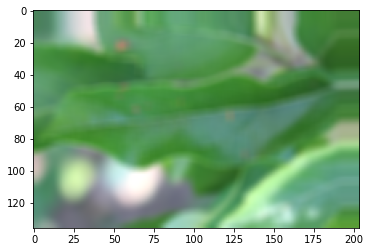

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


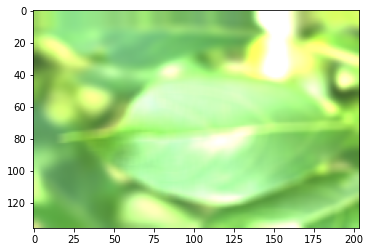

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


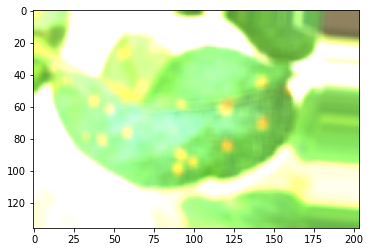

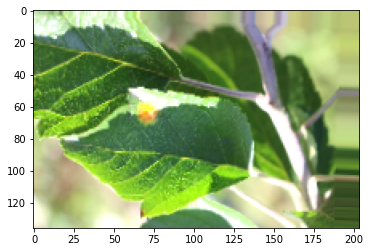

In [5]:
for img in train_generator:
    for i in img[0]:
        plt.imshow(i)
        plt.show()
    break

In [7]:
  
"""
Define our custom loss function.
"""
from keras import backend as K
import tensorflow as tf

import dill


def binary_focal_loss(gamma=2., alpha=.25):
    """
    Binary form of focal loss.
      FL(p_t) = -alpha * (1 - p_t)**gamma * log(p_t)
      where p = sigmoid(x), p_t = p or 1 - p depending on if the label is 1 or 0, respectively.
    References:
        https://arxiv.org/pdf/1708.02002.pdf
    Usage:
     model.compile(loss=[binary_focal_loss(alpha=.25, gamma=2)], metrics=["accuracy"], optimizer=adam)
    """
    def binary_focal_loss_fixed(y_true, y_pred):
        """
        :param y_true: A tensor of the same shape as `y_pred`
        :param y_pred:  A tensor resulting from a sigmoid
        :return: Output tensor.
        """
        pt_1 = tf.where(tf.equal(y_true, 1), y_pred, tf.ones_like(y_pred))
        pt_0 = tf.where(tf.equal(y_true, 0), y_pred, tf.zeros_like(y_pred))

        epsilon = K.epsilon()
        # clip to prevent NaN's and Inf's
        pt_1 = K.clip(pt_1, epsilon, 1. - epsilon)
        pt_0 = K.clip(pt_0, epsilon, 1. - epsilon)

        return -K.mean(alpha * K.pow(1. - pt_1, gamma) * K.log(pt_1)) \
               -K.mean((1 - alpha) * K.pow(pt_0, gamma) * K.log(1. - pt_0))

    return binary_focal_loss_fixed


def categorical_focal_loss(gamma=2., alpha=.25):
    """
    Softmax version of focal loss.
           m
      FL = ∑  -alpha * (1 - p_o,c)^gamma * y_o,c * log(p_o,c)
          c=1
      where m = number of classes, c = class and o = observation
    Parameters:
      alpha -- the same as weighing factor in balanced cross entropy
      gamma -- focusing parameter for modulating factor (1-p)
    Default value:
      gamma -- 2.0 as mentioned in the paper
      alpha -- 0.25 as mentioned in the paper
    References:
        Official paper: https://arxiv.org/pdf/1708.02002.pdf
        https://www.tensorflow.org/api_docs/python/tf/keras/backend/categorical_crossentropy
    Usage:
     model.compile(loss=[categorical_focal_loss(alpha=.25, gamma=2)], metrics=["accuracy"], optimizer=adam)
    """
    def categorical_focal_loss_fixed(y_true, y_pred):
        """
        :param y_true: A tensor of the same shape as `y_pred`
        :param y_pred: A tensor resulting from a softmax
        :return: Output tensor.
        """

        # Scale predictions so that the class probas of each sample sum to 1
        y_pred /= K.sum(y_pred, axis=-1, keepdims=True)

        # Clip the prediction value to prevent NaN's and Inf's
        epsilon = K.epsilon()
        y_pred = K.clip(y_pred, epsilon, 1. - epsilon)

        # Calculate Cross Entropy
        cross_entropy = -y_true * K.log(y_pred)

        # Calculate Focal Loss
        loss = alpha * K.pow(1 - y_pred, gamma) * cross_entropy

        # Compute mean loss in mini_batch
        return K.mean(loss, axis=1)

    return categorical_focal_loss_fixed


In [76]:
INTERESTING_CLASS_ID = 1    
    
def single_class_accuracy(y_true, y_pred):
    class_id_true = K.argmax(y_true, axis=-1)
    class_id_preds = K.argmax(y_pred, axis=-1)
    accuracy_mask = K.cast(K.equal(class_id_preds, INTERESTING_CLASS_ID), 'int32')
    class_acc_tensor = K.cast(K.equal(class_id_true, class_id_preds), 'int32') * accuracy_mask
    class_acc = K.sum(class_acc_tensor) / K.maximum(K.sum(accuracy_mask), 1)
    return class_acc

In [9]:
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()
import keras
from efficientnet.keras import EfficientNetB6

pretrained = EfficientNetB6(input_shape=(image_size[0],image_size[1],3), include_top=False, weights="imagenet")
#l = 8
#if l == 0:
#    pretrained.trainable = False
#else:
#    for layer in pretrained.layers[:-l]:
#        layer.trainable = False
model = keras.Sequential([
  pretrained,
  keras.layers.GlobalAveragePooling2D(),
  keras.layers.Dense(3, activation='softmax')
])
model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.0001), loss=[categorical_focal_loss(alpha=.25, gamma=2)],metrics=['accuracy'])

In [10]:
from keras.callbacks import ModelCheckpoint

checkpoint = ModelCheckpoint(
    "best_model.hdf5", 
    monitor='val_accuracy',
    verbose=1,
    save_best_only=True, 
    mode='max', 
    period=1, 
    save_weights_only=True)


checkpoint_loss = ModelCheckpoint(
    "best_model_loss.hdf5", 
    monitor='val_loss',
    verbose=1,
    save_best_only=True, 
    mode='max', 
    period=1, 
    save_weights_only=True)

STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=test_generator.n//test_generator.batch_size
history = model.fit_generator(generator=train_generator,
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    validation_data=test_generator,
                    validation_steps=STEP_SIZE_VALID,
                    callbacks=[checkpoint,checkpoint_loss],
                    epochs=20)

Epoch 1/20
389/389 [==============================] - 115s 297ms/step - loss: 0.0278 - accuracy: 0.6401 - val_loss: 0.0133 - val_accuracy: 0.7965

Epoch 00001: val_accuracy improved from -inf to 0.79651, saving model to best_model.hdf5

Epoch 00001: val_loss improved from -inf to 0.01332, saving model to best_model_loss.hdf5
Epoch 2/20
389/389 [==============================] - 111s 285ms/step - loss: 0.0171 - accuracy: 0.8036 - val_loss: 0.0102 - val_accuracy: 0.9053

Epoch 00002: val_accuracy improved from 0.79651 to 0.90533, saving model to best_model.hdf5

Epoch 00002: val_loss did not improve from 0.01332
Epoch 3/20
389/389 [==============================] - 110s 283ms/step - loss: 0.0155 - accuracy: 0.8216 - val_loss: 0.0029 - val_accuracy: 0.9467

Epoch 00003: val_accuracy improved from 0.90533 to 0.94675, saving model to best_model.hdf5

Epoch 00003: val_loss did not improve from 0.01332
Epoch 4/20
389/389 [==============================] - 110s 283ms/step - loss: 0.0125 - accu

KeyboardInterrupt: 

In [11]:
model.load_weights("best_model.hdf5")

In [ ]:
loss =history.history['loss']
val_loss = history.history['val_loss']
plt.plot(loss,label='loss')
plt.plot(val_loss,label='val_loss')
plt.legend()
plt.show()

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
plt.plot(acc,label='acc')
plt.plot(val_acc,label='val_acc')
plt.legend()
plt.show()

In [ ]:
probs_efnns = model.predict(X_test, verbose=1)
sub.loc[:, 'healthy':] = probs_efnns
sub.to_csv('./submission_efnns.csv', index=False)
sub.head()

In [ ]:
import numpy as np
from IPython.display import clear_output
from sklearn.model_selection import train_test_split

size = (image_size[1], image_size[0])

# Test data of the challenge (no y values)
print("Loading Test Images")
X_test = []
progress = 0
for image_id in test_data["image_id"]:
    X_test.append(load_image(image_id,size))
    print('Loading Test Images: %f%%'%((progress/len(test_data["image_id"])*100)))
    progress+=1
    clear_output(wait=True)
X_test = np.array(X_test)

In [ ]:
model.load_weights('best_model.hdf5')

[[63.  0.  0.]
 [ 0. 76.  0.]
 [ 6.  0. 63.]]


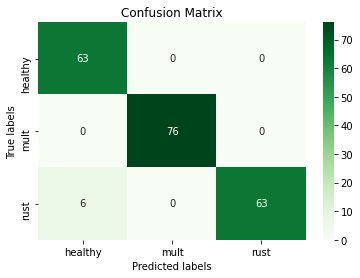

In [14]:
# Generate Confusion Matrix

from sklearn.metrics import confusion_matrix
import seaborn as sns

def decode_one_hot(y_one_hot):
    y = []
    for row in y_one_hot:
        y.append(np.argmax(row))
    return np.array(y)

confus = np.zeros((3,3))
i=0
for data in test_generator:
    y_pred = model.predict_classes(data[0])
    y_true = decode_one_hot(data[1])
    confus_step = confusion_matrix(y_true, y_pred)
    if len(confus_step[0]) < 3:
        continue
    confus = confus + confus_step
    if i>50:
        break
    i+=1

ax= plt.subplot()
sns.heatmap(confus, annot=True, ax = ax,cmap='Greens'); #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['healthy','mult','rust','scab']); ax.yaxis.set_ticklabels(['healthy','mult','rust','scab']);    
    

print(confus)

In [ ]:
labels = ['healthy','multiple_diseases','rust','scab']
label_pos = [0,1,2,3]
label_names = {0: 'healthy', 1: 'multiple_diseases', 2: 'rust', 3: 'scab'}


predicts = model.predict(X_test, verbose=1)
for i in range(len(predicts)):
    if(max(predicts[i]) < 0.90):
        f, axarr = plt.subplots(1,2)
        f.set_figwidth(15)
        predict = predicts[i]
        img = X_test[i]
        axarr[0].bar(label_pos, predict, align='center', alpha=0.5)
        axarr[0].set_xticks(label_pos)
        axarr[0].set_xticklabels(labels)
        axarr[1].imshow(img)
        plt.show()

In [67]:
import keras

gen = keras.preprocessing.image.ImageDataGenerator(
    horizontal_flip=True,
    vertical_flip=True,
        rescale=1/255,
    rotation_range=10,
    zoom_range=.3,
    fill_mode='nearest',
    shear_range=0.1
    )

imgs = gen.flow_from_directory(
                './test/leaf-image-segmentation/base/',
                target_size=(256, 256),
                batch_size=13,
                class_mode='categorical',
                shuffle=True)

Found 13 images belonging to 1 classes.


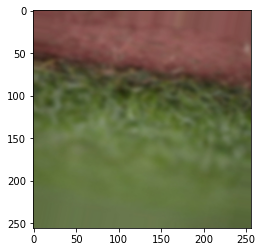

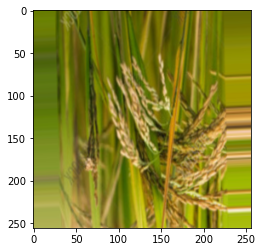

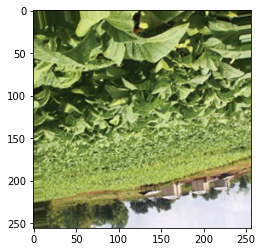

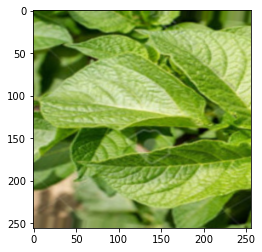

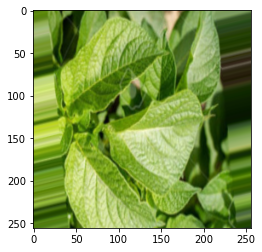

...

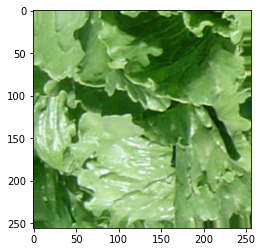

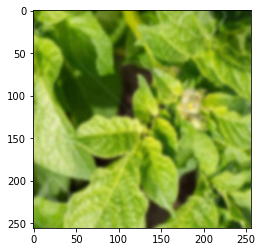

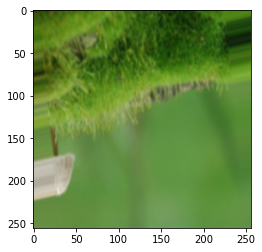

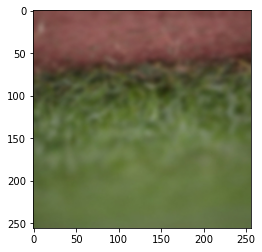

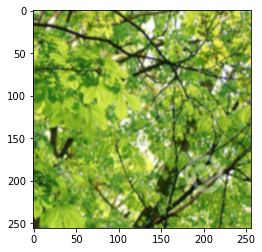

In [69]:
import scipy.misc
import matplotlib

i=298
for img in imgs:
    plt.imshow(img[0][0])
    plt.show()
    matplotlib.image.imsave('./test/leaf-image-segmentation/ref_imgs/'+str(i)+'.jpg', img[0][0])
    i+=1
    if i>650:
        break